<a href="https://colab.research.google.com/github/farhanwew/Digital-Image-processing/blob/main/Segmentation_Based_on_Similarity.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Segmentasi Citra Berbasis Similaritas**

---

### 1. Konsep Segmentasi Berbasis Similaritas

Segmentasi berbasis similaritas mengelompokkan piksel-piksel yang memiliki kesamaan nilai intensitas, tekstur, atau atribut lainnya. Pendekatan ini berfokus pada keseragaman lokal atau global dalam citra untuk memisahkan objek dari latar belakang.

Metode populer:

* *Global Thresholding*
* *Otsu’s Method*
* *Optimal Thresholding Iteratif*
* *Adaptive Thresholding*
* *Histogram of Gradient (HoG)*

---

### 2. Global Thresholding

#### Konsep:

Global thresholding membagi piksel menjadi dua kelompok (foreground/objek dan background/latar belakang) berdasarkan nilai ambang (threshold) tetap.

#### Implementasi:

```python
import cv2
import matplotlib.pyplot as plt

img = cv2.imread('image.jpg', 0)
_, thresh = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)

plt.imshow(thresh, cmap='gray')
plt.title('Global Thresholding')
plt.axis('off')
plt.show()
```

#### Eksperimen:

```python
for t in [50, 100, 150, 200]:
    _, th = cv2.threshold(img, t, 255, cv2.THRESH_BINARY)
    plt.figure(), plt.imshow(th, cmap='gray')
    plt.title(f'Threshold: {t}'), plt.axis('off')
```

---

### 3. Otsu’s Method

#### Konsep:

Otsu mencari ambang optimal dengan meminimalkan variansi intra-kelas.

#### Implementasi:

```python
_, otsu = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
plt.imshow(otsu, cmap='gray')
plt.title('Otsu Thresholding')
plt.axis('off')
plt.show()
```

#### Visualisasi Histogram:

```python
plt.hist(img.ravel(), bins=256, range=[0,256])
plt.axvline(_, color='r', label=f'Threshold: {_:.2f}')
plt.title('Histogram dan Threshold Otsu')
plt.legend()
plt.show()
```

---

### 4. Optimal Thresholding (Iteratif)

#### Konsep:

1. Tentukan threshold awal (misal rata-rata intensitas)
2. Kelompokkan piksel menjadi dua berdasarkan threshold
3. Hitung rata-rata masing-masing kelompok
4. Update threshold sebagai rata-rata dari dua nilai rata-rata tersebut
5. Ulangi hingga konvergen

#### Implementasi:

```python
def optimal_threshold(img):
    T = img.mean()
    while True:
        G1 = img[img > T]
        G2 = img[img <= T]
        new_T = (G1.mean() + G2.mean()) / 2
        if abs(T - new_T) < 1:
            break
        T = new_T
    return T

T = optimal_threshold(img)
ret, opt_thresh = cv2.threshold(img, T, 255, cv2.THRESH_BINARY)
plt.imshow(opt_thresh, cmap='gray')
plt.title(f'Optimal Threshold = {T:.2f}')
plt.axis('off')
plt.show()
```

---

### 5. Adaptive Thresholding

#### Konsep:

* Menentukan threshold untuk tiap piksel berdasarkan lingkungan lokal (blok kecil).
* Menggunakan ambang lokal berdasarkan rata-rata atau Gaussian dari lingkungan sekitar setiap piksel.

#### Implementasi:

```python
adaptive = cv2.adaptiveThreshold(img, 255,
                                 cv2.ADAPTIVE_THRESH_MEAN_C,
                                 cv2.THRESH_BINARY, 11, 2)
plt.imshow(adaptive, cmap='gray')
plt.title('Adaptive Thresholding')
plt.axis('off')
plt.show()
```

#### Eksperimen Blok Ukuran:

```python
for block_size in [11, 15, 25]:
    adaptive = cv2.adaptiveThreshold(img, 255,
                                     cv2.ADAPTIVE_THRESH_MEAN_C,
                                     cv2.THRESH_BINARY, block_size, 2)
    plt.figure(), plt.imshow(adaptive, cmap='gray')
    plt.title(f'Block size: {block_size}')
```

---

### 6. Histogram of Oriented Gradient (HoG)

#### Konsep:

* Ekstraksi fitur tepi dan orientasi gradien pada blok-blok kecil citra (lokal).
* Digunakan untuk deteksi objek dan segmentasi berbasis fitur.

#### Implementasi (Visualisasi HoG):

```python
from skimage.feature import hog
from skimage import exposure

# Hitung HOG
fd, hog_image = hog(img, orientations=9, pixels_per_cell=(8, 8),
                    cells_per_block=(2, 2), visualize=True)

plt.imshow(hog_image, cmap='gray')
plt.title('Histogram of Gradient - Feature Image')
plt.axis('off')
plt.show()
```

#### Eksperimen:

```python
# Hitung HOG
fd, hog_image = hog(img, orientations=8, pixels_per_cell=(16, 16),
                    cells_per_block=(1, 1), visualize=True)

# Rescale HOG untuk visualisasi
hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

plt.figure(figsize=(10, 5))
plt.subplot(121), plt.imshow(img, cmap='gray'), plt.title('Original')
plt.subplot(122), plt.imshow(hog_image_rescaled, cmap='gray'), plt.title('HOG')
plt.show()
```

---

### 7. Integrasi dengan Penyambungan Tepi

Thresholding dapat dikombinasikan dengan penyambungan tepi untuk menyaring hasil tepi:

```python
edges = cv2.Canny(img, 100, 200)
masked = cv2.bitwise_and(edges, edges, mask=thresh)
plt.imshow(masked, cmap='gray')
plt.title('Tepi setelah Thresholding')
plt.axis('off')
plt.show()
```

---

### 8. Kesimpulan

* Segmentasi berbasis similaritas efektif untuk memisahkan objek dengan intensitas homogen.
* Global thresholding cepat namun tidak fleksibel, cocok untuk citra dengan kontras tinggi.
* Metode Otsu, optimal thresholding, dan adaptive thresholding memberikan hasil otomatis, sehingga lebih fleksibel untuk kondisi pencahayaan tidak merata.
* HoG membuka jalan menuju segmentasi berbasis pembelajaran fitur (feature-based segmentation).
* Eksperimen parameter seperti ambang batas dan ukuran blok menunjukkan sensitivitas metode terhadap variasi input.
* Integrasi dengan metode seperti deteksi tepi dapat meningkatkan kualitas segmentasi akhir.

# Load Data

In [12]:
import cv2
import matplotlib.pyplot as plt

In [6]:
! unzip /content/Image.zip

Archive:  /content/Image.zip
   creating: Image/
 extracting: Image/finger.jpg        
 extracting: Image/Head.png          
 extracting: Image/paper.png         
 extracting: Image/ReadME.md         
 extracting: Image/maple.jpg         
 extracting: Image/coin.png          
 extracting: Image/maple2.jpg        
 extracting: Image/cell.jpg          
 extracting: Image/canada.jpg        
 extracting: Image/writing.png       
 extracting: Image/mountain.jpg      
 extracting: Image/fingerprint.png   


In [19]:
finger = cv2.imread('Image/finger.jpg', 0)
head = cv2.imread('Image/Head.png', 0)
paper = cv2.imread('Image/paper.png', 0)
maple = cv2.imread('Image/maple.jpg', 0)
coin = cv2.imread('Image/coin.png', 0)
maple2 = cv2.imread('Image/maple2.jpg', 0)
cell = cv2.imread('Image/cell.jpg', 0)
canada = cv2.imread('Image/canada.jpg', 0)
writing = cv2.imread('Image/writing.png', 0)
mountain = cv2.imread('Image/mountain.jpg', 0)
fingerprint = cv2.imread('Image/fingerprint.png', 0)

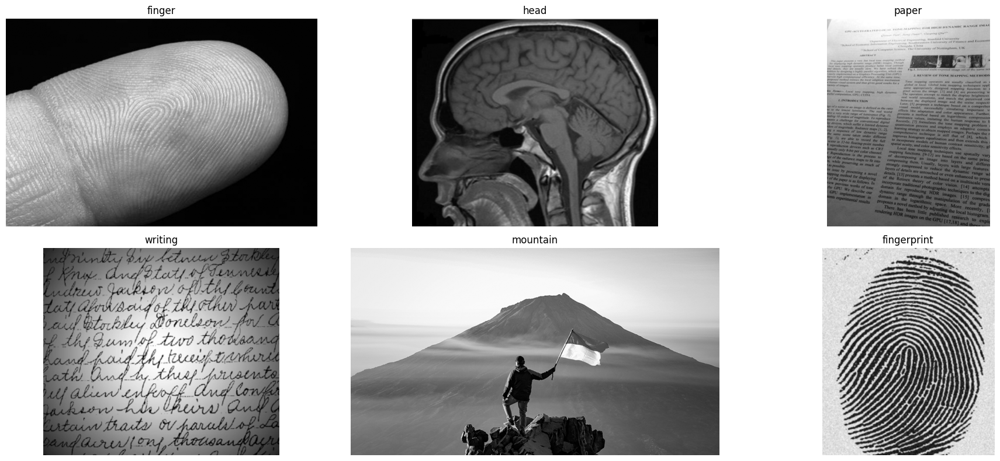

In [24]:
images = [
    ('finger', cv2.imread('Image/finger.jpg', 0)),
    ('head', cv2.imread('Image/Head.png', 0)),
    ('paper', cv2.imread('Image/paper.png', 0)),
    ('writing', cv2.imread('Image/writing.png', 0)),
    ('mountain', cv2.imread('Image/mountain.jpg', 0)),
    ('fingerprint', cv2.imread('Image/fingerprint.png', 0)),
]

# Menentukan jumlah kolom
cols = 3
# Menentukan jumlah baris secara dinamis
rows = (len(images) + cols - 1) // cols

# Membuat subplot
fig, axes = plt.subplots(rows, cols, figsize=(20, 4 * rows))

# Menampilkan gambar
for i, (title, img) in enumerate(images):
    row = i // cols
    col = i % cols
    axes[row, col].imshow(img, cmap='gray')
    axes[row, col].set_title(title)
    axes[row, col].axis('off')

# Menghilangkan subplot kosong jika ada
for i in range(len(images), rows * cols):
    row = i // cols
    col = i % cols
    axes[row, col].axis('off')

plt.tight_layout()
plt.show()

# Implementasi kode

## Global Thresholding

Example for finger with 127 treshold

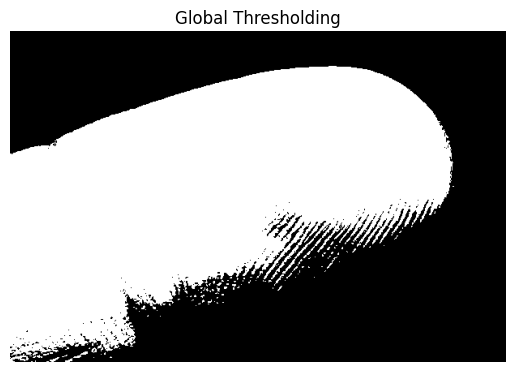

In [21]:
import cv2
import matplotlib.pyplot as plt

_, thresh = cv2.threshold(finger, 127, 255, cv2.THRESH_BINARY)

plt.imshow(thresh, cmap='gray')
plt.title('Global Thresholding')
plt.axis('off')
plt.show()

Experiment With diffrent treshold

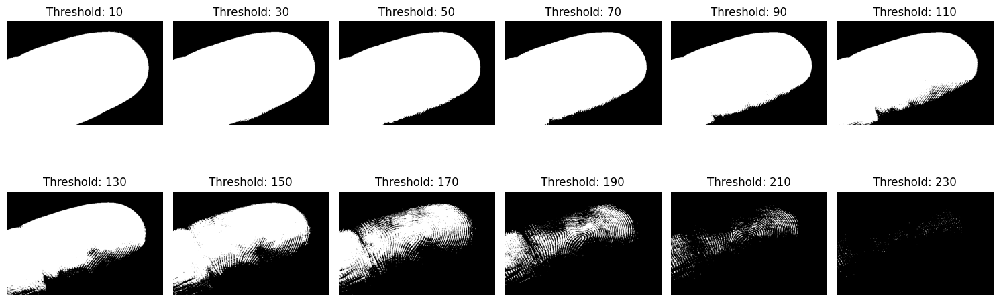

In [32]:
# Threshold values
threshold_values = list(range(10, 250, 20))

# Jumlah kolom
cols = 6
# Jumlah baris (dihitung secara otomatis)
rows = (len(threshold_values) + cols - 1) // cols

# Membuat subplot
plt.figure(figsize=(15, 3 * rows))
for i, t in enumerate(threshold_values):
    _, th = cv2.threshold(finger, t, 255, cv2.THRESH_BINARY)
    plt.subplot(rows, cols, i + 1)  # Membuat subplot n x 5
    plt.imshow(th, cmap='gray')
    plt.title(f'Threshold: {t}')
    plt.axis('off')

plt.tight_layout()
plt.show()

different image

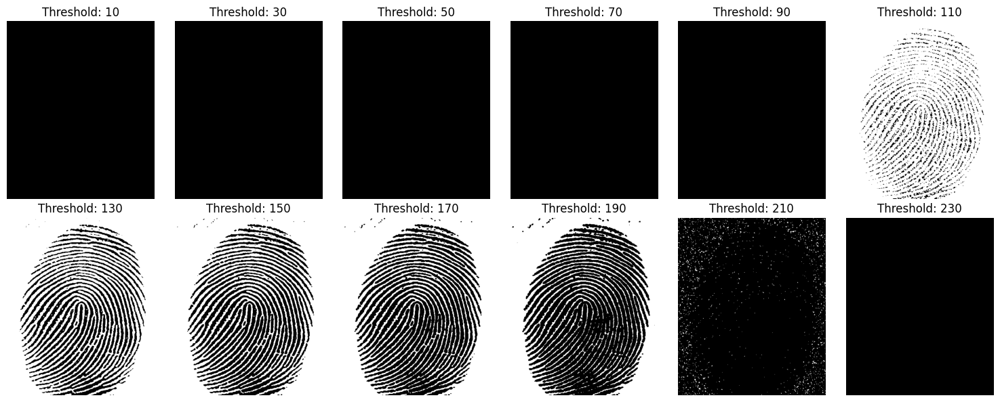

In [34]:
# Threshold values
threshold_values = list(range(10, 250, 20))

# Jumlah kolom
cols = 6
# Jumlah baris (dihitung secara otomatis)
rows = (len(threshold_values) + cols - 1) // cols

# Membuat subplot
plt.figure(figsize=(15, 3 * rows))
for i, t in enumerate(threshold_values):
    _, th = cv2.threshold(fingerprint, t, 255, cv2.THRESH_BINARY)
    plt.subplot(rows, cols, i + 1)  # Membuat subplot n x 5
    plt.imshow(th, cmap='gray')
    plt.title(f'Threshold: {t}')
    plt.axis('off')

plt.tight_layout()
plt.show()

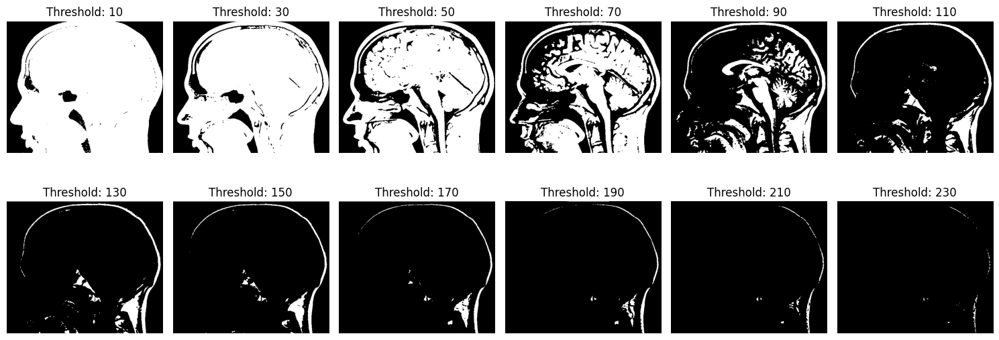

In [35]:
# Threshold values
threshold_values = list(range(10, 250, 20))

# Jumlah kolom
cols = 6
# Jumlah baris (dihitung secara otomatis)
rows = (len(threshold_values) + cols - 1) // cols

# Membuat subplot
plt.figure(figsize=(15, 3 * rows))
for i, t in enumerate(threshold_values):
    _, th = cv2.threshold(head, t, 255, cv2.THRESH_BINARY)
    plt.subplot(rows, cols, i + 1)  # Membuat subplot n x 5
    plt.imshow(th, cmap='gray')
    plt.title(f'Threshold: {t}')
    plt.axis('off')

plt.tight_layout()
plt.show()

## Otsu

Otsu mencari ambang optimal dengan meminimalkan variansi intra-kelas.

finger

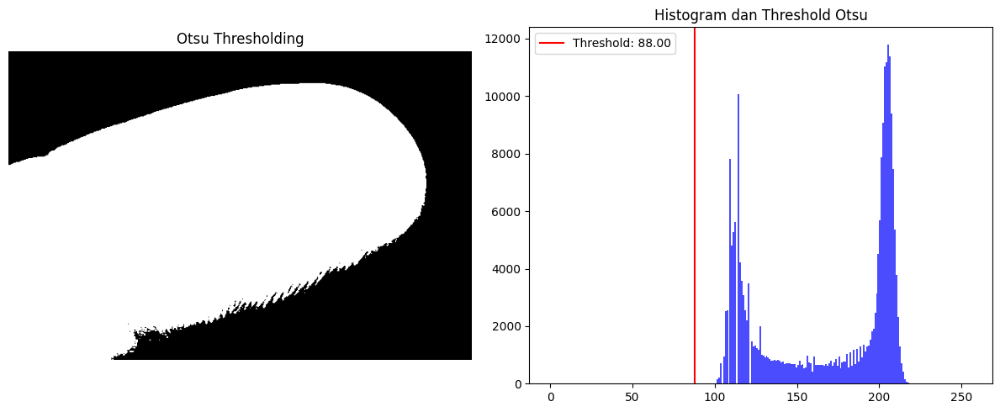

In [38]:
# Otsu's Thresholding
_, otsu = cv2.threshold(finger, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

# Membuat subplot untuk hasil thresholding dan histogram
plt.figure(figsize=(12, 5))

# Subplot 1: Hasil Otsu Thresholding
plt.subplot(1, 2, 1)
plt.imshow(otsu, cmap='gray')
plt.title('Otsu Thresholding')
plt.axis('off')

# Subplot 2: Histogram dan Threshold Otsu
plt.subplot(1, 2, 2)
plt.hist(img.ravel(), bins=256, range=[0, 256], color='blue', alpha=0.7)
plt.axvline(_, color='r', label=f'Threshold: {_:.2f}')
plt.title('Histogram dan Threshold Otsu')
plt.legend()

plt.tight_layout()
plt.show()

fingerprit

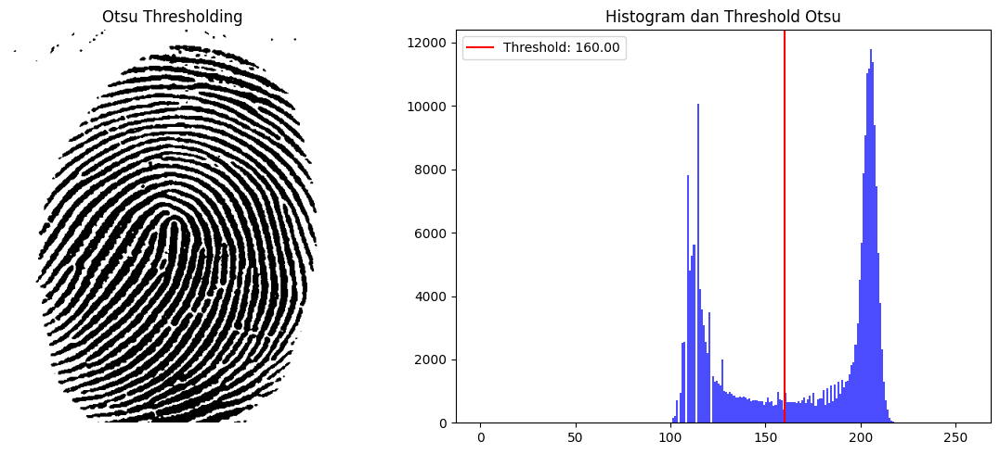

In [40]:
# Otsu's Thresholding
_, otsu = cv2.threshold(fingerprint, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

# Membuat subplot untuk hasil thresholding dan histogram
plt.figure(figsize=(12, 5))

# Subplot 1: Hasil Otsu Thresholding
plt.subplot(1, 2, 1)
plt.imshow(otsu, cmap='gray')
plt.title('Otsu Thresholding')
plt.axis('off')

# Subplot 2: Histogram dan Threshold Otsu
plt.subplot(1, 2, 2)
plt.hist(img.ravel(), bins=256, range=[0, 256], color='blue', alpha=0.7)
plt.axvline(_, color='r', label=f'Threshold: {_:.2f}')
plt.title('Histogram dan Threshold Otsu')
plt.legend()

plt.tight_layout()
plt.show()

head

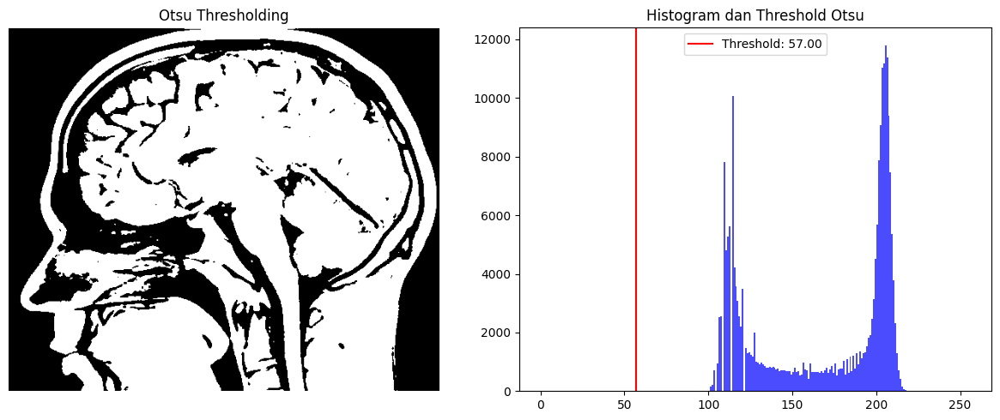

In [41]:
# Otsu's Thresholding
_, otsu = cv2.threshold(head, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

# Membuat subplot untuk hasil thresholding dan histogram
plt.figure(figsize=(12, 5))

# Subplot 1: Hasil Otsu Thresholding
plt.subplot(1, 2, 1)
plt.imshow(otsu, cmap='gray')
plt.title('Otsu Thresholding')
plt.axis('off')

# Subplot 2: Histogram dan Threshold Otsu
plt.subplot(1, 2, 2)
plt.hist(img.ravel(), bins=256, range=[0, 256], color='blue', alpha=0.7)
plt.axvline(_, color='r', label=f'Threshold: {_:.2f}')
plt.title('Histogram dan Threshold Otsu')
plt.legend()

plt.tight_layout()
plt.show()

## Optimal Thresholding

use several method for determining the treshold

In [48]:
# Fungsi Optimal Threshold dengan Mean
def optimal_threshold_mean(img):
    T = img.mean()
    while True:
        G1 = img[img > T]
        G2 = img[img <= T]
        new_T = (G1.mean() + G2.mean()) / 2
        if abs(T - new_T) < 1:
            break
        T = new_T
    return T

# Fungsi Optimal Threshold dengan Median
def optimal_threshold_median(img):
    T = np.median(img)  # Menggunakan np.median
    while True:
        G1 = img[img > T]
        G2 = img[img <= T]
        new_T = (G1.mean() + G2.mean()) / 2
        if abs(T - new_T) < 1:
            break
        T = new_T
    return T

# Fungsi Optimal Threshold dengan Otsu
def optimal_threshold_otsu(img):
    _, T = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    while True:
        G1 = img[img > T]
        G2 = img[img <= T]
        new_T = (G1.mean() + G2.mean()) / 2
        if abs(T - new_T) < 1:
            break
        T = new_T
    return T

# Fungsi Optimal Threshold dengan Midpoint
def optimal_threshold_midpoint(img):
    T = (img.min() + img.max()) / 2  # Midpoint Threshold Awal
    while True:
        G1 = img[img > T]
        G2 = img[img <= T]
        new_T = (G1.mean() + G2.mean()) / 2
        if abs(T - new_T) < 1:
            break
        T = new_T
    return T

In [49]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def process_and_visualize_thresholding(img):
    """
    Lakukan thresholding dengan berbagai metode dan tampilkan hasilnya dalam subplot.

    Parameters:
        img (numpy.ndarray): Gambar asli dalam format grayscale.
    """
    # Thresholding untuk setiap metode
    _, result_mean = cv2.threshold(img, 128, 255, cv2.THRESH_BINARY)  # Simulasi hasil metode Mean
    _, result_median = cv2.threshold(img, 100, 255, cv2.THRESH_BINARY)  # Simulasi hasil metode Median
    _, result_otsu = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)  # Hasil Otsu
    _, result_midpoint = cv2.threshold(img, 150, 255, cv2.THRESH_BINARY)  # Simulasi hasil metode Midpoint

    # Daftar hasil dan nama metode
    results = [result_mean, result_median, result_otsu, result_midpoint]
    method_names = ['Mean Threshold', 'Median Threshold', 'Otsu Threshold', 'Midpoint Threshold']

    # Membuat subplot
    plt.figure(figsize=(12, 8))

    # Gambar asli
    plt.subplot(2, 3, 1)
    plt.imshow(img, cmap='gray')
    plt.title('Gambar Asli')
    plt.axis('off')

    # Tambahkan hasil thresholding ke subplot
    for i, (result, name) in enumerate(zip(results, method_names), start=2):
        plt.subplot(2, 3, i)
        plt.imshow(result, cmap='gray')
        plt.title(name)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

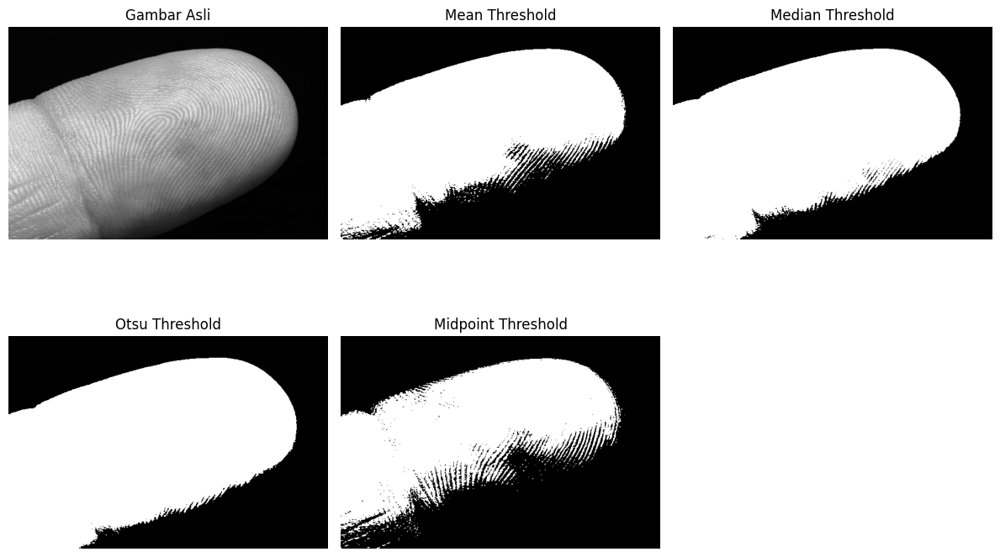

In [50]:
process_and_visualize_thresholding(finger)

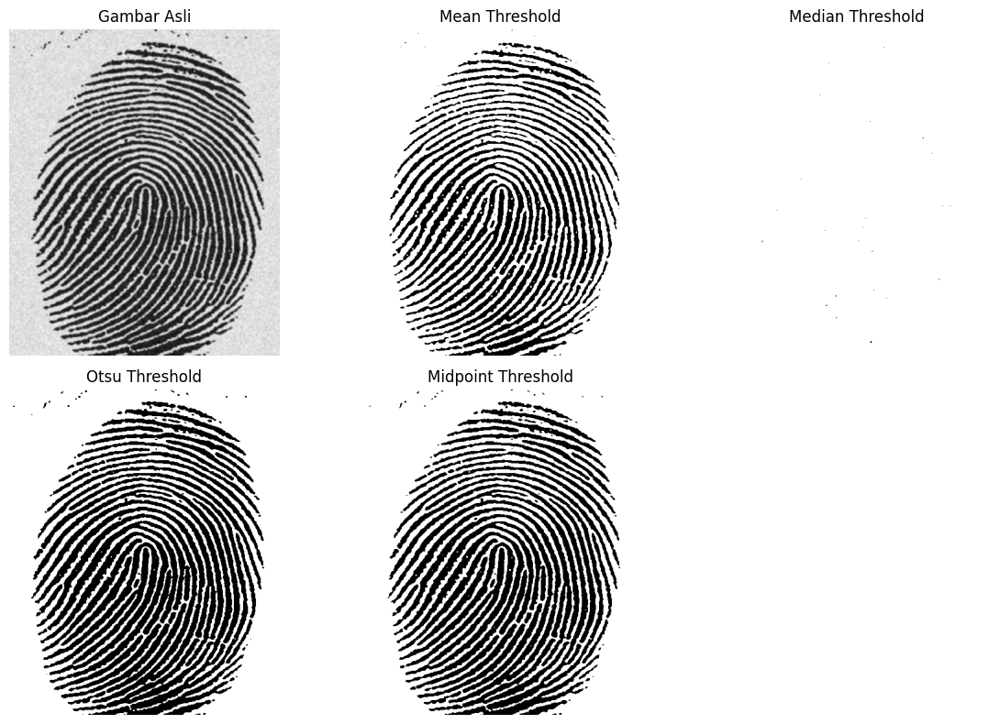

In [51]:
process_and_visualize_thresholding(fingerprint)

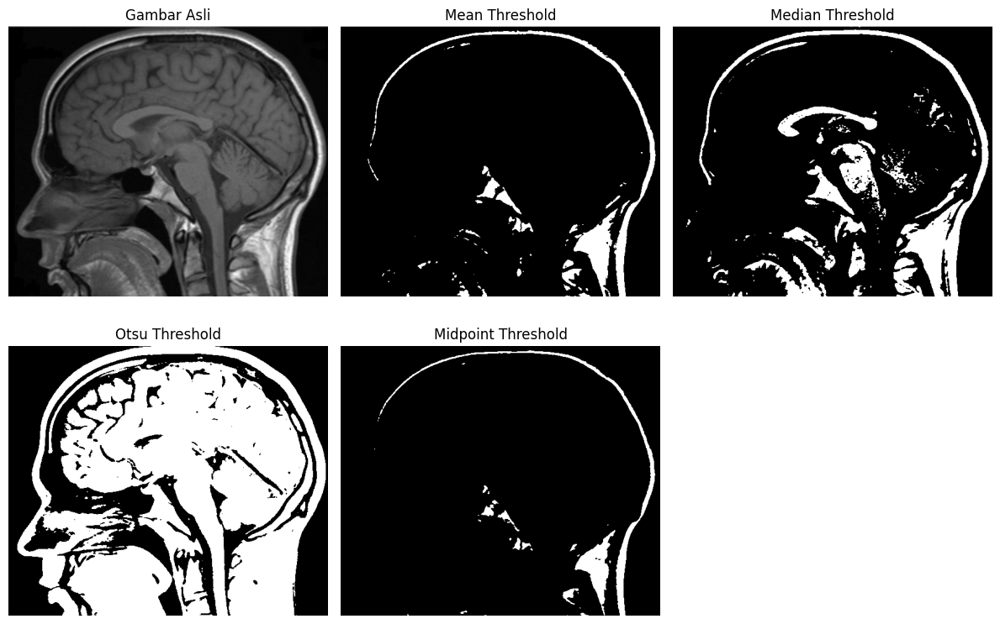

In [52]:
process_and_visualize_thresholding(head)

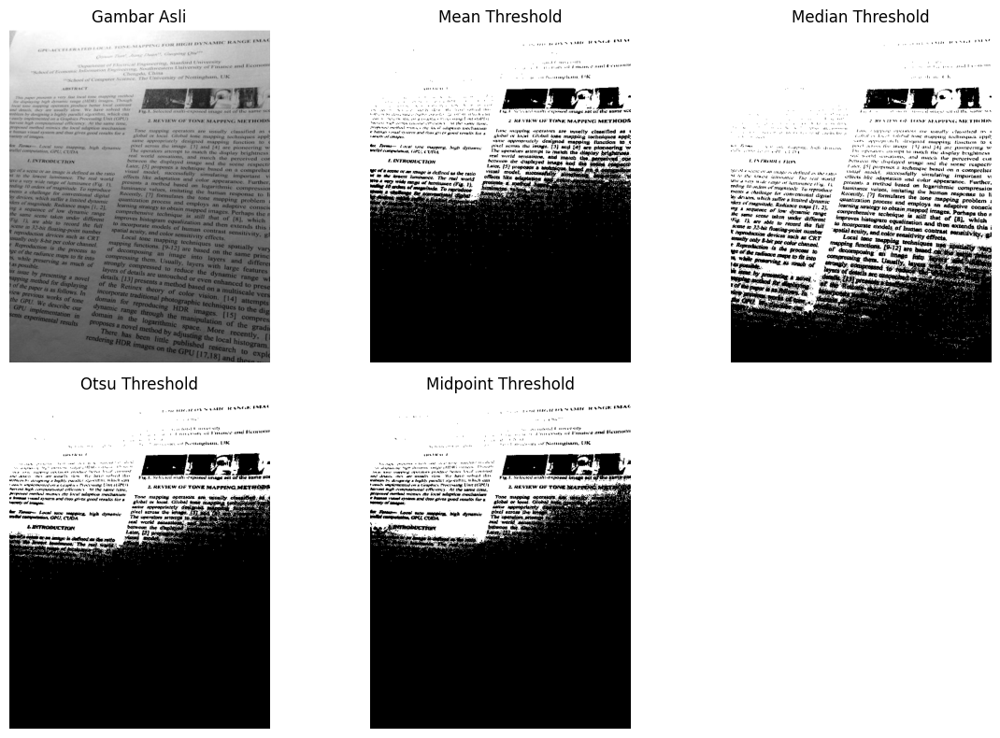

In [54]:
process_and_visualize_thresholding(paper)

## Adaptive Thresholding

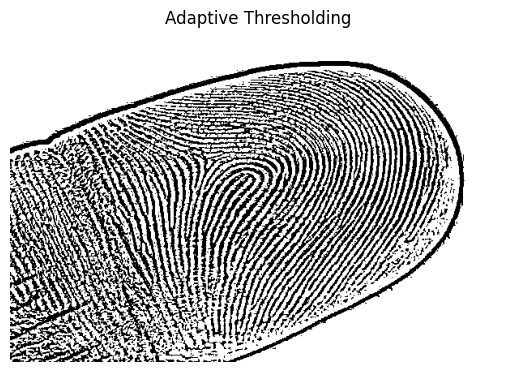

In [55]:
adaptive = cv2.adaptiveThreshold(finger, 255,
                                 cv2.ADAPTIVE_THRESH_MEAN_C,
                                 cv2.THRESH_BINARY, 11, 2)
plt.imshow(adaptive, cmap='gray')
plt.title('Adaptive Thresholding')
plt.axis('off')
plt.show()

In [70]:
import cv2
import matplotlib.pyplot as plt
import math

def experiment_adaptive_threshold(img, block_sizes):
    """
    Lakukan eksperimen adaptive thresholding dengan berbagai ukuran block size dalam grid subplot.

    Parameters:
        img (numpy.ndarray): Gambar input dalam format grayscale.
        block_sizes (list of int): Daftar nilai block size untuk adaptive thresholding.
    """
    # Validasi: Pastikan block_sizes adalah bilangan ganjil
    block_sizes = [size for size in block_sizes if size % 2 == 1]
    if not block_sizes:
        raise ValueError("Semua block size harus berupa bilangan ganjil.")

    # Hitung jumlah baris dan kolom untuk grid
    num_methods = len(block_sizes)
    cols = math.ceil(math.sqrt(num_methods))  # Jumlah kolom
    rows = math.ceil(num_methods / cols)     # Jumlah baris

    # Membuat subplot sesuai jumlah block size
    plt.figure(figsize=(cols * 5, rows * 5))
    for i, block_size in enumerate(block_sizes, start=1):
        # Terapkan adaptive thresholding
        adaptive = cv2.adaptiveThreshold(img, 255,
                                         cv2.ADAPTIVE_THRESH_MEAN_C,
                                         cv2.THRESH_BINARY, block_size, 2)
        # Tambahkan hasil ke subplot
        plt.subplot(rows, cols, i)
        plt.imshow(adaptive, cmap='gray')
        plt.title(f'Block size: {block_size}')
        plt.axis('off')

    plt.tight_layout()
    plt.show()

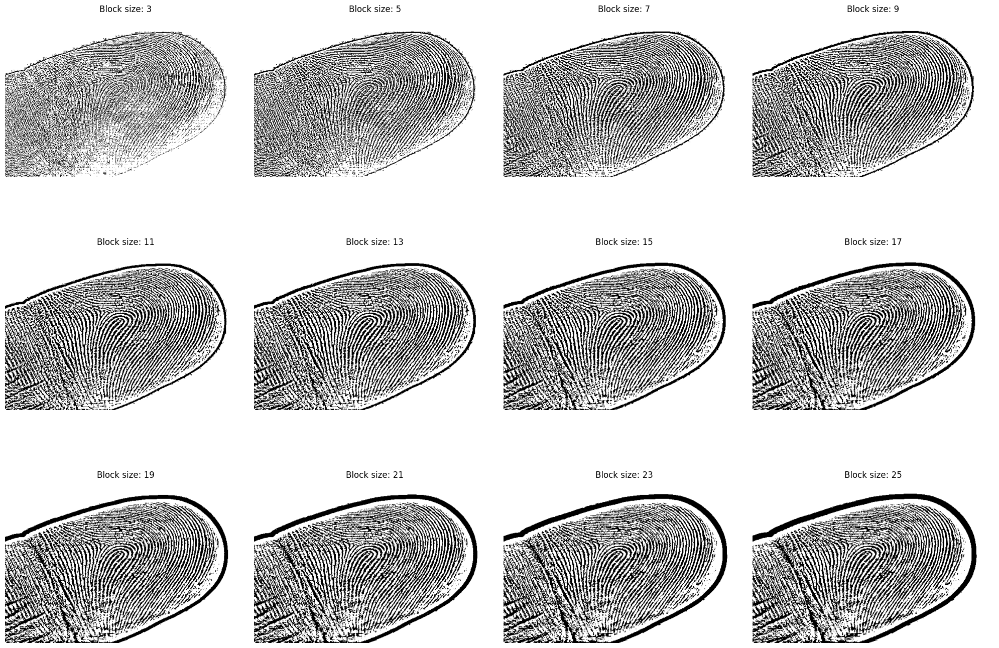

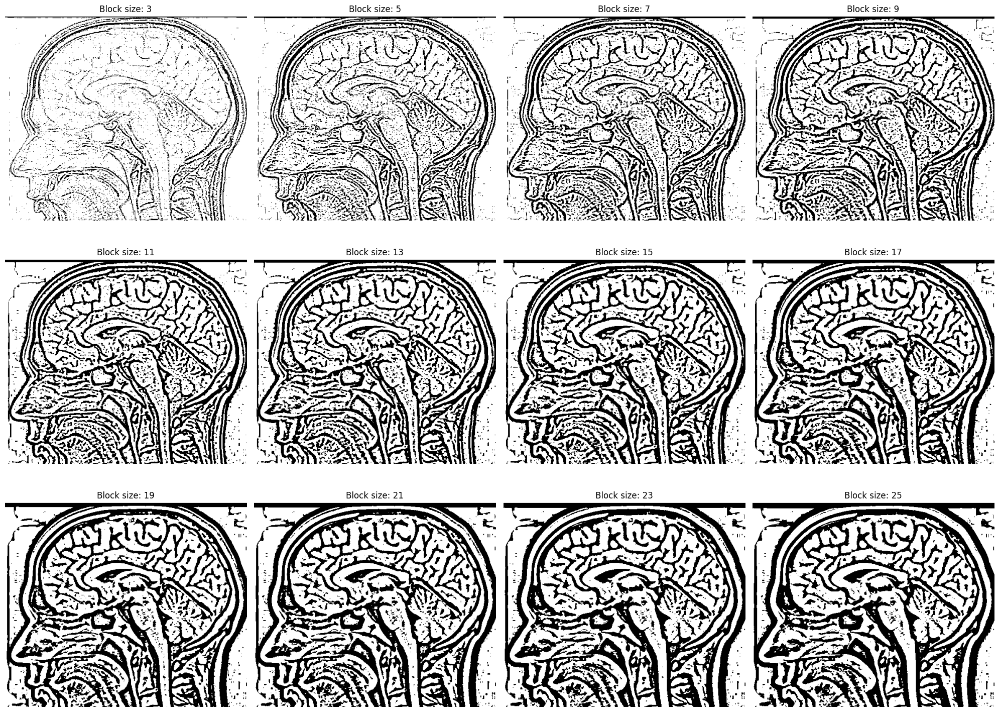

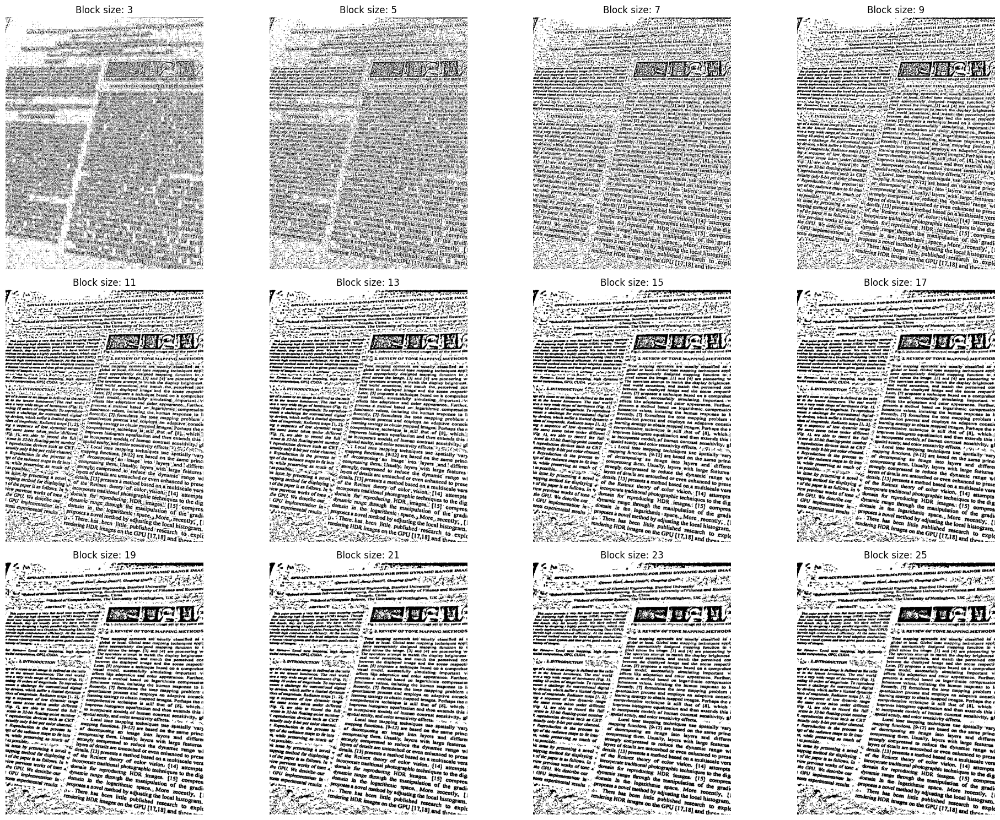

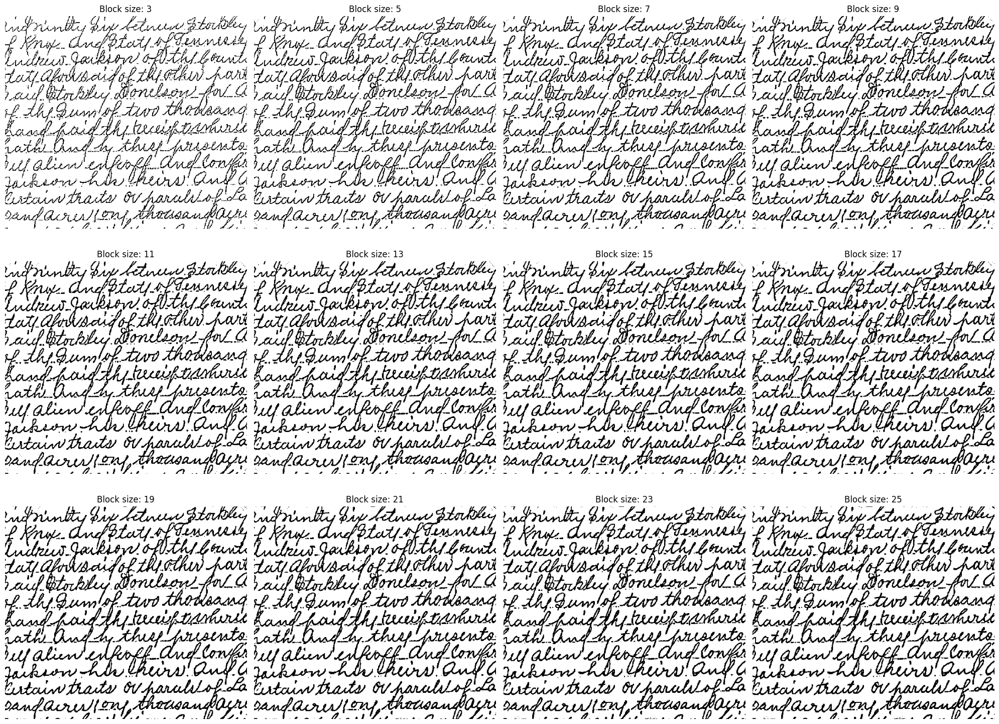

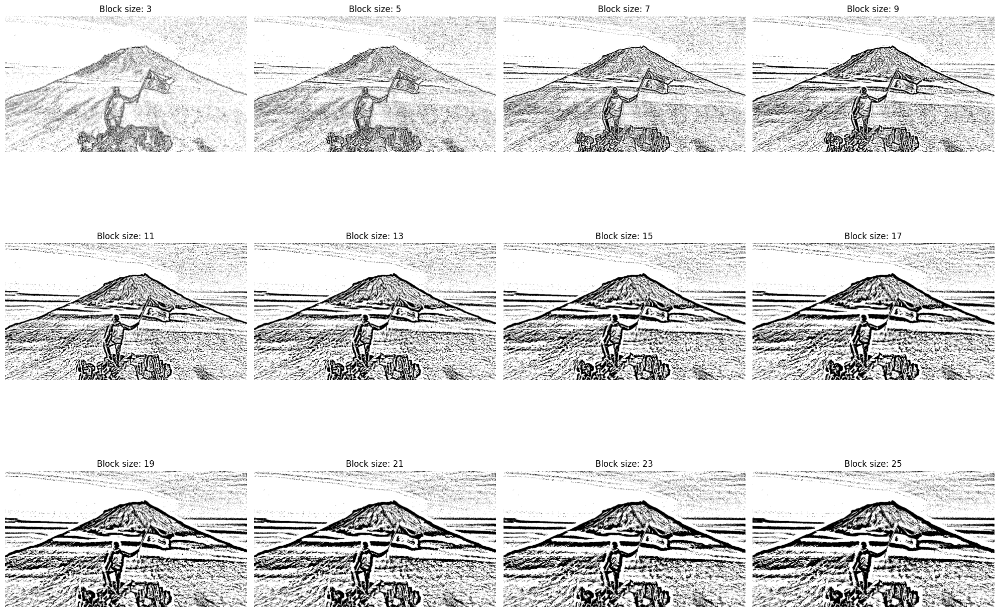

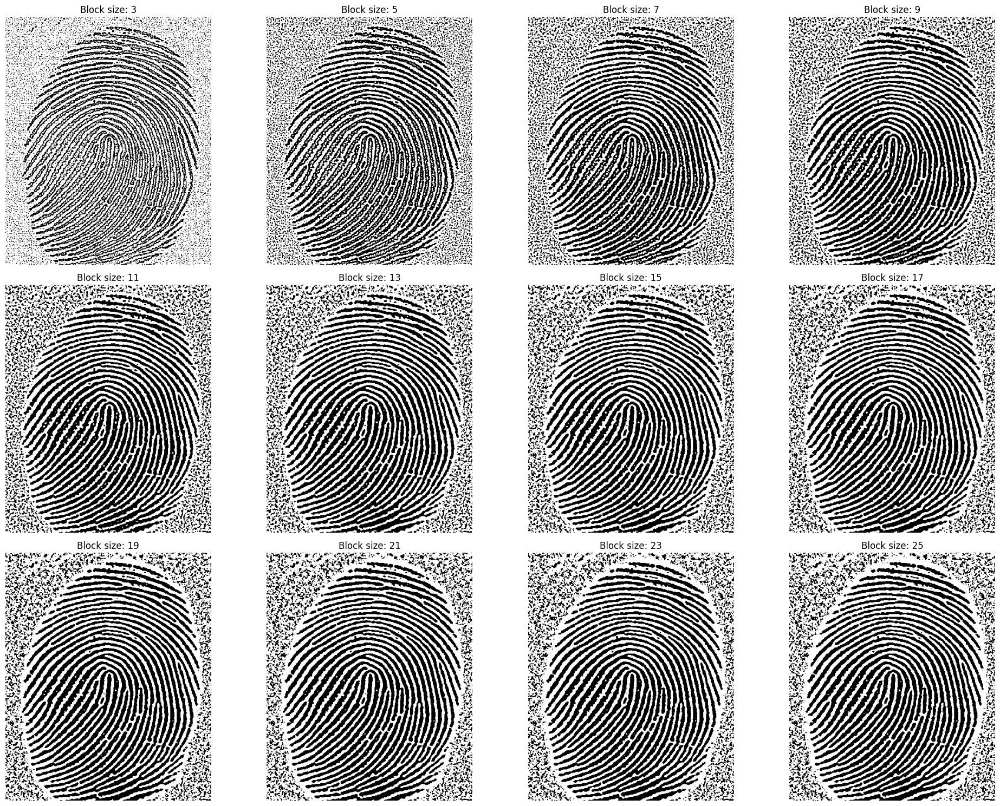

In [69]:
block_sizes = list(range(3, 26, 2))

for image in images:
  experiment_adaptive_threshold(image[1], block_sizes)


in some image , larger block size can make the edges appear darker.

## Histogram of Oriented Gradient (HoG)

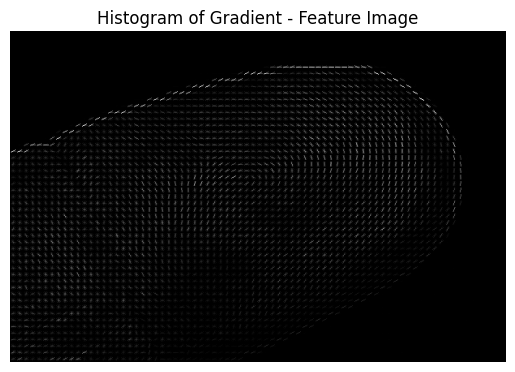

In [71]:
from skimage.feature import hog
from skimage import exposure

# Hitung HOG
fd, hog_image = hog(finger, orientations=9, pixels_per_cell=(8, 8),
                    cells_per_block=(2, 2), visualize=True)

plt.imshow(hog_image, cmap='gray')
plt.title('Histogram of Gradient - Feature Image')
plt.axis('off')
plt.show()

In [77]:
def Hog(image):
  fd, hog_image = hog(image, orientations=8, pixels_per_cell=(16, 16),
                    cells_per_block=(1, 1), visualize=True)

  # Rescale HOG untuk visualisasi
  hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

  plt.figure(figsize=(10, 5))
  plt.subplot(121), plt.imshow(image, cmap='gray'), plt.title('Original')
  plt.subplot(122), plt.imshow(hog_image_rescaled, cmap='gray'), plt.title('HOG')
  plt.show()

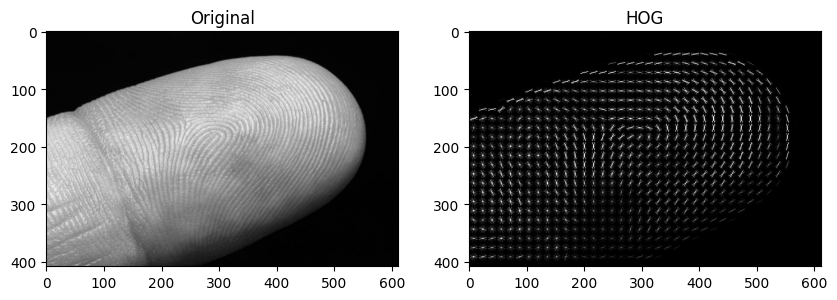

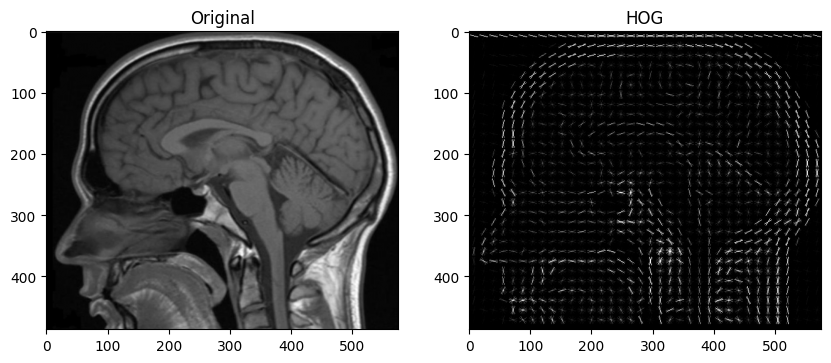

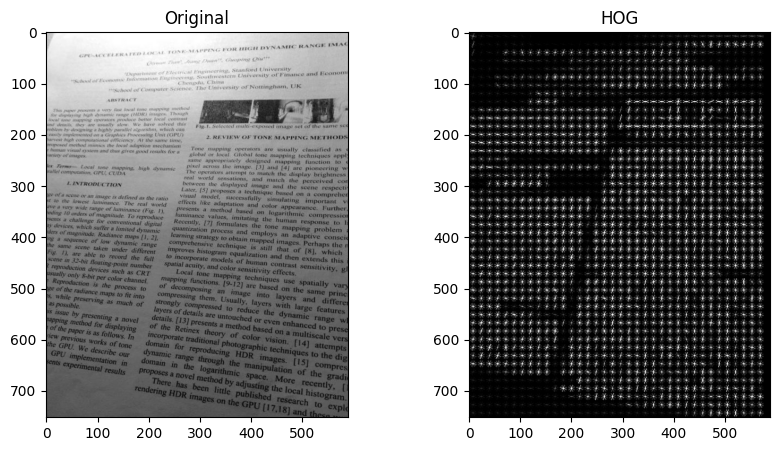

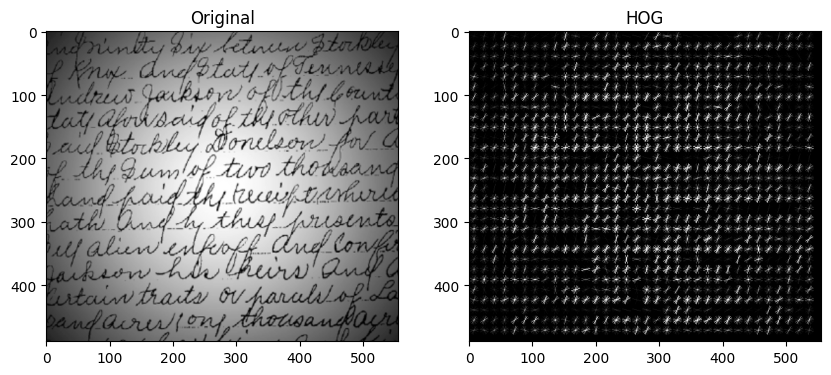

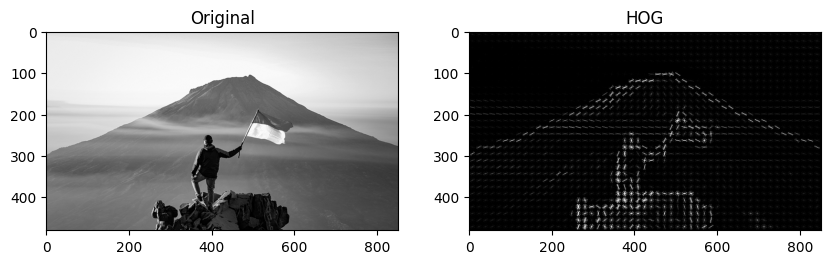

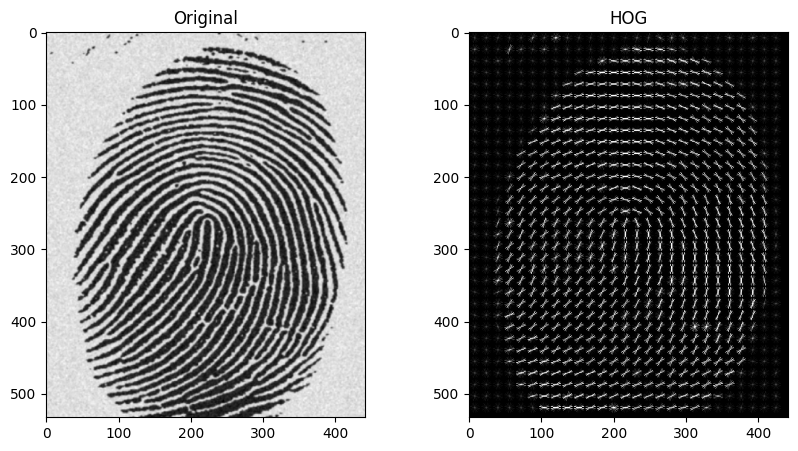

In [78]:
for image in images:
  Hog(image[1])

## Integrasi dengan Penyambungan Tepi

In [81]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def apply_thresholds_and_edges(img):
    """
    Terapkan berbagai teknik thresholding (global, adaptive, Otsu) dan tampilkan hasilnya bersama dengan
    deteksi tepi menggunakan Canny Edge Detection.

    Parameters:
        img (numpy.ndarray): Gambar input dalam format grayscale.
    """
    # 1. Global Thresholding (Binary)
    _, thresh_binary = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)

    # 2. Adaptive Thresholding (Mean)
    adaptive_mean = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 2)

    # 3. Adaptive Thresholding (Gaussian)
    adaptive_gaussian = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)

    # 4. Otsu's Thresholding
    _, thresh_otsu = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Daftar thresholding hasil
    thresholds = [
        ("Global Threshold", thresh_binary),
        ("Adaptive Mean", adaptive_mean),
        ("Adaptive Gaussian", adaptive_gaussian),
        ("Otsu Threshold", thresh_otsu)
    ]

    # 5. Deteksi tepi dengan Canny setelah setiap thresholding
    edges = []
    for name, threshold in thresholds:
        edge = cv2.Canny(threshold, 100, 200)
        edges.append((f"{name} Edges", edge))

    # 6. Plot hasil thresholding
    plt.figure(figsize=(12, 8))
    for i, (name, threshold) in enumerate(thresholds, start=1):
        plt.subplot(2, len(thresholds), i)
        plt.imshow(threshold, cmap='gray')
        plt.title(name)
        plt.axis('off')

    # 7. Plot hasil deteksi tepi
    for i, (name, edge) in enumerate(edges, start=1):
        plt.subplot(2, len(edges), len(thresholds) + i)
        plt.imshow(edge, cmap='gray')
        plt.title(name)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

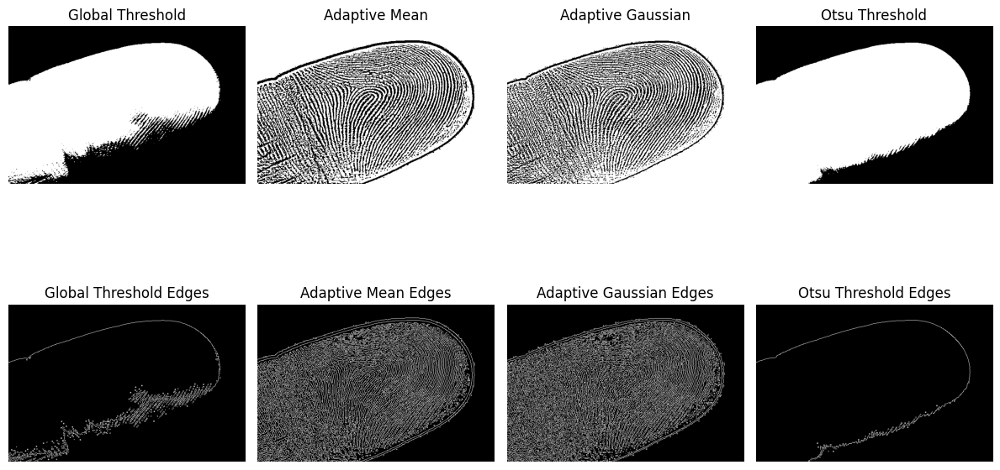

In [82]:
apply_thresholds_and_edges(finger)

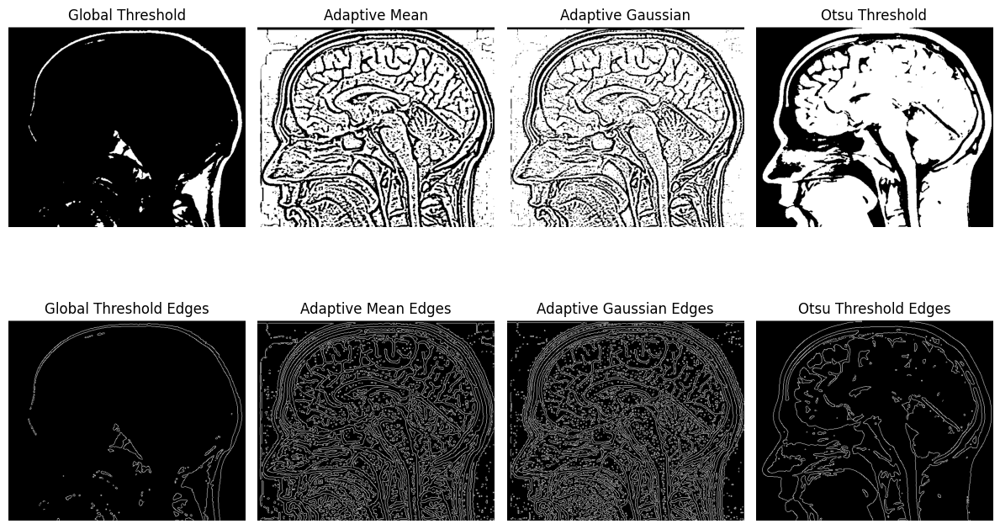

In [83]:
apply_thresholds_and_edges(head)

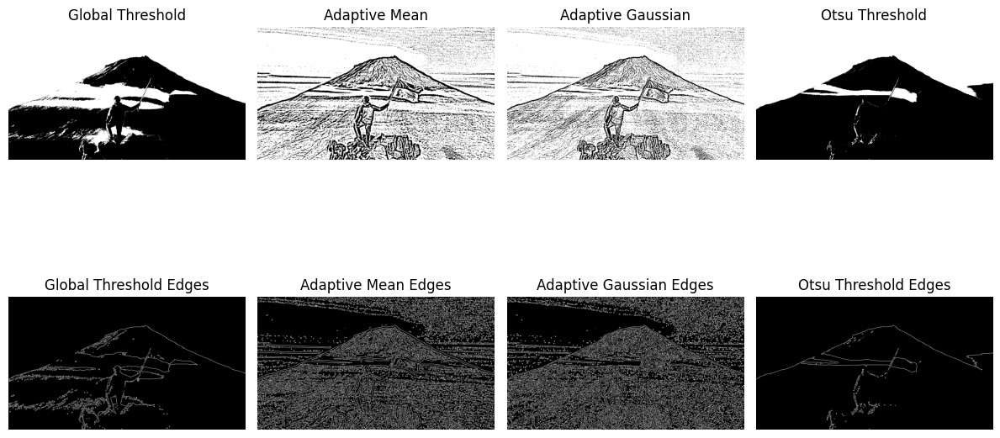

In [86]:
apply_thresholds_and_edges(mountain)